This is the code to classify(binary) images as cat or dogs using Neural networks.

# Importing required packages

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import cv2
import numpy as np
from matplotlib import pyplot as plt

import pathlib
import os

# Setting device to GPU if available, will be using this everywhere

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Will use {}'.format(device))

Will use cuda


# Reading Training & Testin Data, also converting from default BGR to RGB

In [3]:
X_train_cats = [cv2.imread('Data/training_set/cats/small/'+img) for img in os.listdir('Data/training_set/cats/small')]
X_train_dogs = [cv2.imread('Data/training_set/dogs/small/'+img) for img in os.listdir('Data/training_set/dogs/small')]
X_test_cats = [cv2.imread('Data/test_set/cats/small/'+img) for img in os.listdir('Data/test_set/cats/small')]
X_test_dogs = [cv2.imread('Data/test_set/dogs/small/'+img) for img in os.listdir('Data/test_set/dogs/small')]

X_train_cats = [cv2.cvtColor(img,cv2.COLOR_BGR2RGB) for img in X_train_cats]
X_train_dogs = [cv2.cvtColor(img,cv2.COLOR_BGR2RGB) for img in X_train_dogs]
X_test_cats = [cv2.cvtColor(img,cv2.COLOR_BGR2RGB) for img in X_test_cats]
X_test_dogs = [cv2.cvtColor(img,cv2.COLOR_BGR2RGB) for img in X_test_dogs]

# Dataset has images of different dimensions, making it every image square by adding black filler bars.

In [4]:
def img_squared(img):
    h,w,c = img.shape
    if w < h:
        img = np.concatenate((img,np.zeros((h,h-w,c),dtype=np.int32)),axis=1)
    elif h < w:
        img = np.concatenate((img,np.zeros((w-h,w,c),dtype=np.int32)))
    return img

In [5]:
X_train_cats = [img_squared(img) for img in X_train_cats]
X_train_dogs = [img_squared(img) for img in X_train_dogs]
X_test_cats = [img_squared(img) for img in X_test_cats]
X_test_dogs = [img_squared(img) for img in X_test_dogs]

# Resizing images to a smaller resolution for faster performance

In [6]:
X_train_cats = [cv2.resize(img.astype('uint8'),(128,128)) for img in X_train_cats]
X_train_dogs = [cv2.resize(img.astype('uint8'),(128,128)) for img in X_train_dogs]
X_test_cats = [cv2.resize(img.astype('uint8'),(128,128)) for img in X_test_cats]
X_test_dogs = [cv2.resize(img.astype('uint8'),(128,128)) for img in X_test_dogs]

# Converting to tensors

In [7]:
X_train_cats = torch.Tensor(X_train_cats)
X_train_dogs = torch.Tensor(X_train_dogs)
X_test_cats = torch.Tensor(X_test_cats)
X_test_dogs = torch.Tensor(X_test_dogs)

# Creating quivalent targets

In [8]:
Y_train_cats = torch.zeros((X_train_cats.shape[0],1))
Y_train_dogs = torch.ones((X_train_dogs.shape[0],1))
Y_test_cats = torch.zeros((X_test_cats.shape[0],1))
Y_test_dogs = torch.ones((X_test_dogs.shape[0],1))

# Combining cats and dogs to one each for training & tesing in device 

In [9]:
X_train = torch.cat((X_train_cats,X_train_dogs)).to(device)
X_test = torch.cat((X_test_cats,X_test_dogs)).to(device)

Y_train = torch.cat((Y_train_cats,Y_train_dogs)).to(device)
Y_test = torch.cat((Y_test_cats,Y_test_dogs)).to(device)

# Normalising inputs

In [10]:
X_train = X_train/255
X_test = X_test/255

# Looking at the dataset

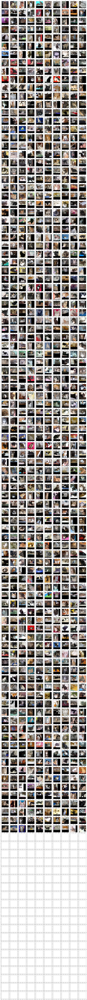

In [11]:
img  = X_train[:].to('cpu')
fig,ax = plt.subplots(120,10,figsize=(30,360))
for i in range(100):
    for j in range(10):
        ind = i*10 + j
        ax[i][j].imshow(img[ind])
        ax[i][j].title.set_text(int(Y_train[ind]))

In [ ]:
img  = X_test[:].to('cpu')
fig,ax = plt.subplots(10,10,figsize=(30,30))
for i in range(10):
    for j in range(10):
        ind = i*10 + j
        ax[i][j].imshow(img[ind])
        ax[i][j].title.set_text(int(Y_train[ind]))

# Reshaping input tensor

In [12]:
m_train,h,w,c = X_train.shape
X_train = X_train.reshape(m_train,-1)
print(X_train.shape, Y_train.shape)

m_test,h,w,c = X_test.shape
X_test = X_test.reshape(m_test,-1)
print(X_test.shape, Y_test.shape)

torch.Size([2000, 49152]) torch.Size([2000, 1])
torch.Size([100, 49152]) torch.Size([100, 1])


# 4 Layer model

In [13]:
class Model2(nn.Module):
    def __init__(self,features,drop_pctg=0):
        super().__init__()
        self.Z1 = nn.Linear(features,20)
        self.Z2 = nn.Linear(20,7)
        #self.Z2_5 = nn.Linear(20,7)
        self.Z3 = nn.Linear(7,5)
        self.Z4 = nn.Linear(5,1)
        
        self.initialize_weights()
        
        self.dropout = nn.Dropout(drop_pctg)
    
    def forward(self,X):
        X = F.relu(self.Z1(X))
        X = self.dropout(X)
        X = F.relu(self.Z2(X))
        #X = self.dropout(X)
        #X = F.relu(self.Z2_5(X))
        #X = self.dropout(X)
        X = F.relu(self.Z3(X))
        #X = self.dropout(X)
        X = torch.sigmoid(self.Z4(X))
        return X
    
    def initialize_weights(self):
        nn.init.xavier_uniform_(self.Z1.weight)
        nn.init.xavier_uniform_(self.Z2.weight)
        #nn.init.xavier_uniform_(self.Z2_5.weight)
        nn.init.xavier_uniform_(self.Z3.weight)
        nn.init.xavier_uniform_(self.Z4.weight)        

In [14]:
torch.manual_seed(2048)
n = h*w*c
finder = Model2(n,drop_pctg=0).to(device)
losses=[]
optimizer = optim.SGD(finder.parameters(), lr=0.002, weight_decay=0.08)

finder

Model2(
  (Z1): Linear(in_features=49152, out_features=20, bias=True)
  (Z2): Linear(in_features=20, out_features=7, bias=True)
  (Z3): Linear(in_features=7, out_features=5, bias=True)
  (Z4): Linear(in_features=5, out_features=1, bias=True)
  (dropout): Dropout(p=0, inplace=False)
)

In [15]:
with torch.no_grad():
    out = finder(X_test)>0.5
    out = out.int()
    comp = out==Y_test
    comp = torch.sum(comp.int())
    train_acc = comp/m_test
    print('Test accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_test))

Test accuracy: 0.5 
Classified 50 correct out of 100


In [16]:
prev_test_loss = 100

999th epoch loss:0.6272416710853577, test_loss:0.6747061610221863
1999th epoch loss:0.601304829120636, test_loss:0.6733813285827637
2999th epoch loss:0.5865843296051025, test_loss:0.6745317578315735
Early stop at 2999, 0.6745317578315735 > 0.6733813285827637


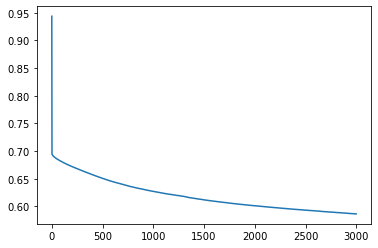

In [17]:
for i in range(25000):
    finder.zero_grad()
    Y_hat = finder(X_train)
    loss = F.binary_cross_entropy(Y_hat,Y_train)
    losses.append(loss)
    loss.backward()
    optimizer.step()
    if i%1000 == 999:
        test_loss = F.binary_cross_entropy(finder(X_test),Y_test)
        print('{}th epoch loss:{}, test_loss:{}'.format(i,loss,test_loss))
        if test_loss > prev_test_loss*1.001:
            print('Early stop at {}, {} > {}'.format(i,test_loss,prev_test_loss))
            break
        prev_test_loss = test_loss
        loss
prev_test_loss = test_loss
plt.plot(losses)

In [18]:
with torch.no_grad():
    out = finder(X_train)>0.5
    out = out.int()
    comp = out==Y_train
    comp = torch.sum(comp.int())
    train_acc = comp/m_train
    print('Training accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_train))

Training accuracy: 0.7670000195503235 
Classified 1534 correct out of 2000


In [19]:
with torch.no_grad():
    out = finder(X_test)>0.5
    out = out.int()
    comp = out==Y_test
    comp = torch.sum(comp.int())
    train_acc = comp/m_test
    print('Test accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_test))

Test accuracy: 0.6100000143051147 
Classified 61 correct out of 100


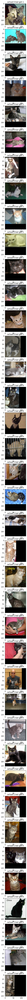

In [20]:
mask = Y_test == out
wrongs = []
for i in range(m_test):
    if mask[i]==False:
        wrongs.append((img[i],Y_test[i],out[i]))

fig,ax = plt.subplots(len(wrongs),figsize=(30,3*len(wrongs)))
for i in range(len(wrongs)):
    ax[i].imshow(wrongs[i][0])
    ax[i].title.set_text('actual {} but got {}'.format(int(wrongs[i][1]),int(wrongs[i][2])))

# 2 Layer Model

In [21]:
class Model(nn.Module):
    def __init__(self,features):
        super().__init__()
        
        self.Z1 = nn.Linear(features,7)
        self.Z2 = nn.Linear(7,1)
        
        self.initialise()
        
    
    def forward(self,X):
        X = F.relu(self.Z1(X))
        X = torch.sigmoid(self.Z2(X))
        return X
    
    def initialise(self):
        nn.init.xavier_uniform_(self.Z1.weight)
        nn.init.xavier_uniform_(self.Z2.weight)

In [22]:
n=h*w*c
finder = Model(n).to(device)
losses=[]
optimizer = optim.SGD(finder.parameters(), lr=0.003, weight_decay=0.01)

finder

Model(
  (Z1): Linear(in_features=49152, out_features=7, bias=True)
  (Z2): Linear(in_features=7, out_features=1, bias=True)
)

In [23]:
with torch.no_grad():
    out = finder(X_test)>0.5
    out = out.int()
    comp = out==Y_test
    comp = torch.sum(comp.int())
    train_acc = comp/m_test
    print('Test accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_test))

Test accuracy: 0.4899999797344208 
Classified 49 correct out of 100


999th epoch loss:0.5757286548614502, test_loss:0.6767192482948303
Early stop at 999, 0.6767192482948303 > 0.6745317578315735


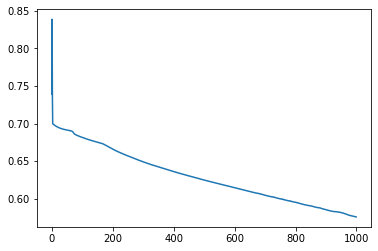

In [24]:
for i in range(25000):
    finder.zero_grad()
    Y_hat = finder(X_train)
    loss = F.binary_cross_entropy(Y_hat,Y_train)
    losses.append(loss)
    loss.backward()
    optimizer.step()
    if i%1000 == 999:
        test_loss = F.binary_cross_entropy(finder(X_test),Y_test)
        print('{}th epoch loss:{}, test_loss:{}'.format(i,loss,test_loss))
        if test_loss > prev_test_loss*1.001:
            print('Early stop at {}, {} > {}'.format(i,test_loss,prev_test_loss))
            break
        prev_test_loss = test_loss
        loss
prev_test_loss = test_loss
plt.plot(losses)

In [26]:
with torch.no_grad():
    out = finder(X_train)>0.5
    out = out.int()
    comp = out==Y_train
    comp = torch.sum(comp.int())
    train_acc = comp/m_train
    print('Training accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_train))

Training accuracy: 0.7430000305175781 
Classified 1486 correct out of 2000


In [27]:
with torch.no_grad():
    out = finder(X_test)>0.5
    out = out.int()
    comp = out==Y_test
    comp = torch.sum(comp.int())
    train_acc = comp/m_test
    print('Test accuracy: {} \nClassified {} correct out of {}'.format(train_acc,comp,m_test))

Test accuracy: 0.5399999618530273 
Classified 54 correct out of 100
